In [1]:
# For tips on running notebooks in Google Colab, see
# https://pytorch.org/tutorials/beginner/colab
%matplotlib inline

In [1]:
import pandas as pd

# prerequisites
import torch
th = torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim

import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
plt.rcParams['font.family'] = 'serif'
import numpy as np


from torch.utils.data import TensorDataset, DataLoader
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler

to_tensor = lambda x: torch.tensor(x).to(torch.float32)

In [2]:
import os
import torch

def save_models(models, folder_path):
    # Create the directory if it doesn't exist
    if not os.path.exists(folder_path):
        os.makedirs(folder_path)

    # Save each model
    for model in models:
        model_name = type(model).__name__  # Get the class name of the model
        file_path = os.path.join(folder_path, f"{model_name}.pt")
        torch.save(model.state_dict(), file_path)

    print("Models saved successfully.")

# Example usage:
# save_models([model1, model2], "/path/to/folder")

def load_models(model_objects, folder_path):
    # Load the state dicts for each model
    for model in model_objects:
        model_name = type(model).__name__  # Get the class name of the model
        file_path = os.path.join(folder_path, f"{model_name}.pt")
        model.load_state_dict(torch.load(file_path))

    print("Models loaded successfully.")

# Example usage:
# load_models([model1, model2], "/path/to/folder")



In [12]:
import torch
from torch.utils.data import Dataset, DataLoader, random_split

class CustomDataset(Dataset):
    def __init__(self, X, y):
        # Generate random data for X with shape (N, 20)
        self.X = X.to(th.float32)
        # Generate random data for y with shape (N, 18, 10)
        self.y = y

    def __len__(self):
        return len(self.X)

    def __getitem__(self, idx):
        return self.X[idx], self.y[idx]

In [13]:
# IMPORT DATA HERE

df = pd.read_csv(r"data/FINALDATA.csv")

X = th.tensor(df[['Panel_{}'.format(_i) for _i in range(20)]].values)
y = th.tensor(df[['Sensor_{}'.format(_i) for _i in range(180)]].values).reshape(X.shape[0], 18, 10) / 100.

In [14]:
# Instantiate the dataset
dataset = CustomDataset(X,y)

In [15]:
batch_size = 24


# Define the split sizes
eval_percent = 0.10
num_eval = int(len(dataset) * eval_percent)
num_train = len(dataset) - num_eval

# Randomly split the dataset into training and evaluation datasets
train_dataset, test_dataset = random_split(dataset, [num_train, num_eval])

# print(f"Training dataset size: {len(train_dataset)}")
# print(f"Test dataset size: {len(test_dataset)}")

# Set batch size


# Create DataLoader for the training dataset
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)

# Create DataLoader for the evaluation dataset
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

In [16]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class CustomConvNet(nn.Module):
    def __init__(self, num_1d_layers=3, num_2d_layers=2):# num_channels=180):
        super(CustomConvNet, self).__init__()
        
        # Define initial parameters for the 1D conv layers
        initial_channels = 16  # Initial number of channels
        self.shape_1d = 20
        self.shape_2d = (18, 10)
        
        # 1D Convolutional Layers
        self.conv1d_layers = nn.ModuleList()
        in_channels = 1
        for i in range(num_1d_layers - 1):
            out_channels = initial_channels * (2 ** i)
            self.conv1d_layers.append(nn.Sequential(
                nn.Conv1d(in_channels, out_channels, kernel_size=3, stride=1, padding=1),
                nn.BatchNorm1d(out_channels),
                nn.ReLU(inplace=True),
                nn.Dropout(0.1)  # Regularization
            ))
            in_channels = out_channels
        
        # Last 1D convolution to adjust the channel size exactly to num_channels
        self.conv1d_layers.append(nn.Conv1d(in_channels, self.shape_2d[0] * self.shape_2d[1], 
                                            kernel_size=3, stride=1, padding=1))

        # 2D Convolutional Layers
        self.conv2d_layers = nn.ModuleList()
        in_channels = self.shape_1d
        for i in range(num_2d_layers):
            out_channels = 32 if i < num_2d_layers - 1 else 1  # Final output channel set to 1
            self.conv2d_layers.append(nn.Sequential(
                nn.Conv2d(in_channels, out_channels, kernel_size=(3, 3), stride=1, padding=1),
                nn.BatchNorm2d(out_channels),
                nn.ReLU(inplace=True),
                nn.Dropout(0.2)  # Regularization
            ))
            in_channels = out_channels

    def forward(self, x):
        x = x.unsqueeze(1)  # Add channel dimension (N, 1, L) where L is the sequence length

        # Apply 1D convolutions
        for layer in self.conv1d_layers:
            x = layer(x)

        # Reshape to 2D (N, C, 18, 10)
        x = x.view(x.size(0), -1, 18, 10)  # -1 here will automatically adjust to num_channels
        
        # Apply 2D convolutions
        for layer in self.conv2d_layers:
            x = layer(x)

        return x.squeeze(1)
        
    def forward_encode(self, x):
        x = x.unsqueeze(1)  # Add channel dimension (N, 1, L) where L is the sequence length
        # Apply 1D convolutions
        for layer in self.conv1d_layers:
            x = layer(x)
            
        # Reshape to 2D (N, C, 18, 10)
        x = x.view(x.size(0), -1, 18, 10)  # -1 here will automatically adjust to num_channels
        return x

    def forward_decode(self, x):
        # Apply 2D convolutions
        
        for layer in self.conv2d_layers:
            x = layer(x)
        return x.squeeze(1)


class TransferLearningModel(nn.Module):
    def __init__(self):
        dim_model=20
        
        super(TransferLearningModel, self).__init__()
        self.proj_angle = nn.Linear(1,dim_model)
        self.linear = nn.Linear(dim_model, dim_model)
        
        # self.proj_1d_vec = nn.Linear(180,dim_model)
        # self.map_combined = nn.Linear(dim_model,180)
        self.pretrained = None
        
    def set_pretrained(self, model):
        self.pretrained = model

    def forward(self, input_):
        assert self.pretrained is not None

        x = input_[:,:20]
        a = input_[:,20:21]
        x_ = self.pretrained.forward_encode(x)

        a_ = self.proj_angle(a)
        a_ = self.linear(a_)
        a_ = th.nn.functional.relu(x_)
        
        # a_ = self.proj_angle(a)
        # x_ = self.proj_1d_vec(x_)
        
        x_ = a_ + x_
        #x_ = self.map_combined(x_)
        x_ = self.pretrained.forward_decode(x_)
        return x_


In [17]:

def train_model(model, optimizer, train_loader, losses, epochs=1000):
    model.train()
    losses_ = losses.setdefault('train',{})

    n_updates = 0
    test(model, losses, -1, n_updates)
    for epoch in range(epochs):
        loss, metric = 0., 0.
        for iter, (inputs, targets) in enumerate(train_loader):
            
            optimizer.zero_grad()
            outputs = model(inputs)
            _loss = train_loss_func(outputs, targets)
            _loss.backward()

            torch.nn.utils.clip_grad_norm_(model.parameters(), 1.0)
            optimizer.step()

            _metric = test_eval_func(outputs.detach(), targets)
            
            losses_.setdefault('loss', []).append(_loss.detach())
            losses_.setdefault('metric', []).append(_metric.detach())
            losses_.setdefault('n_updates', []).append(n_updates)
            
            n_updates += 1
            loss = _loss.detach() + loss
            metric = _metric + metric
            
        loss /= (iter + 1)
        metric /= (iter + 1)

        if (epoch+1) % 5 == 0:
            print(f'TRAIN | Epoch {epoch+1}, Loss: {loss.item():.4f}, Metric: {metric.item():.4f}')
            test(model, losses, epoch, n_updates)

def test(model, losses, epoch, n_updates):
    _ = model.eval()
    losses_ = losses.setdefault('test',{})

    loss, metric = th.tensor(0.), th.tensor(0.)
    with torch.no_grad():
        for iter, (inputs, targets) in enumerate(test_loader):
            outputs = model(inputs)
            _loss = train_loss_func(outputs.detach(), targets.detach())
            _metric = test_eval_func(outputs.detach(), targets.detach())
            loss = _loss.item() + loss
            metric = _metric.item() + metric
            
        loss /= (iter + 1)
        metric /= (iter + 1)
        losses_.setdefault('loss', []).append(loss)
        losses_.setdefault('metric', []).append(metric)
        losses_.setdefault('n_updates', []).append(n_updates)
            
    print(f'... TEST | Epoch {epoch+1}, Loss: {loss.item():.4f}, Metric: {metric.item():.4f}')


In [18]:
class MAPELoss(torch.nn.Module):
    def __init__(self):
        super(MAPELoss, self).__init__()

    def forward(self, y_true, y_pred):
        epsilon = 1e-8
        percentage_error = torch.abs((y_true - y_pred) / (torch.abs(y_true) + epsilon))
        mape = torch.mean(percentage_error) * 100.0
        return mape

train_loss_func = MAPELoss()
test_eval_func = nn.MSELoss()
# train_loss_func = nn.MSELoss()
# test_eval_func = MAPELoss()

In [19]:

# Create the model
model = CustomConvNet(num_1d_layers=3, num_2d_layers=2)

if False: # test the model
    #print(model)
    # Creating a dummy input tensor of shape (N, L), where L=20
    input_tensor = torch.randn(5, 20)  # 5 examples, each 1 x 20
    # Forward pass
    output = model(input_tensor)
    print("Output shape:", output.shape)

In [20]:
# Train model

learning_rate = 1e-3
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

losses = {}
train_model(model, optimizer, train_loader, losses,  epochs=50)

... TEST | Epoch 0, Loss: 14696662.0000, Metric: 0.1118


KeyboardInterrupt: 

In [50]:
load_models([model], "model_mape_norm/")

Models loaded successfully.


DCGAN Tutorial
==============

**Author**: [Nathan Inkawhich](https://github.com/inkawhich)


In [22]:
#%matplotlib inline
import argparse
import os
import random
import torch
th = torch
import torch.nn as nn
import torch.nn.parallel
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
import pandas as pd

# Set random seed for reproducibility
manualSeed = 999
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)
torch.use_deterministic_algorithms(True) # Needed for reproducible results

Random Seed:  999


Inputs
======

Let's define some inputs for the run:

-   `dataroot` - the path to the root of the dataset folder. We will
    talk more about the dataset in the next section.
-   `workers` - the number of worker threads for loading the data with
    the `DataLoader`.
-   `batch_size` - the batch size used in training. The DCGAN paper uses
    a batch size of 128.
-   `image_size` - the spatial size of the images used for training.
    This implementation defaults to 64x64. If another size is desired,
    the structures of D and G must be changed. See
    [here](https://github.com/pytorch/examples/issues/70) for more
    details.
-   `nc` - number of color channels in the input images. For color
    images this is 3.
-   `nz` - length of latent vector.
-   `ngf` - relates to the depth of feature maps carried through the
    generator.
-   `ndf` - sets the depth of feature maps propagated through the
    discriminator.
-   `num_epochs` - number of training epochs to run. Training for longer
    will probably lead to better results but will also take much longer.
-   `lr` - learning rate for training. As described in the DCGAN paper,
    this number should be 0.0002.
-   `beta1` - beta1 hyperparameter for Adam optimizers. As described in
    paper, this number should be 0.5.
-   `ngpu` - number of GPUs available. If this is 0, code will run in
    CPU mode. If this number is greater than 0 it will run on that
    number of GPUs.


# REPLACE YOUR DATA HERE

In [51]:
# Root directory for dataset
dataroot = "data/"

In [186]:
device = torch.device('cpu')
# Number of workers for dataloader
workers = 0

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 64

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 12
# nz = 10

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64


# Learning rate for optimizers
lr = 0.0002

# Beta1 hyperparameter for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

Data
====



In [187]:
orig = pd.read_csv(r"data/FINALDATA.csv")

da = (orig['% of Total Area_0'])
sorted_indices = np.argsort(da)

u = (orig[['Panel_{}'.format(_i) for _i in range(20)]].values)
v = (orig[['Sensor_{}'.format(_i) for _i in range(180)]].values).reshape(u.shape[0], 18, 10)

k_top = 200
X = u[sorted_indices][::-1][:k_top]
y = v[sorted_indices][::-1][:k_top]

X = th.tensor(X.astype('float32'))
y = th.tensor(y.astype('float32'))

dataset_gen = CustomDataset(X,y)

In [188]:
# We can use an image folder dataset the way we have it setup.
# Create the dataset

dataloader = torch.utils.data.DataLoader(dataset_gen, batch_size=batch_size,
                                         shuffle=True, num_workers=0)

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Plot some training images

next(iter(dataloader))[0].shape
# real_batch = next(iter(dataloader))
# plt.figure(figsize=(8,8))
# plt.axis("off")
# plt.title("Training Images")
# to_show = vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu()
# to_show = np.transpose(to_show,(1,2,0))
# plt.imshow(to_show)
# plt.show()

torch.Size([24, 20])

In [189]:
print(len(dataset_gen))

200


Implementation
==============

With our input parameters set and the dataset prepared, we can now get
into the implementation. We will start with the weight initialization
strategy, then talk about the generator, discriminator, loss functions,
and training loop in detail.

Weight Initialization
---------------------

From the DCGAN paper, the authors specify that all model weights shall
be randomly initialized from a Normal distribution with `mean=0`,
`stdev=0.02`. The `weights_init` function takes an initialized model as
input and reinitializes all convolutional, convolutional-transpose, and
batch normalization layers to meet this criteria. This function is
applied to the models immediately after initialization.


In [190]:
# custom weights initialization called on ``netG`` and ``netD``
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [191]:
import torch
import torch.nn as nn

class Generator(nn.Module):
    def __init__(self, input_dim, temp=1.0):
        super(Generator, self).__init__()
        # First convolution layer
        self.temp = temp
        
        self.conv1 = nn.Conv1d(in_channels=1, out_channels=16, kernel_size=3, padding=1)
        self.bn1 = nn.BatchNorm1d(16)  # Batch normalization after convolution
        self.relu = nn.ReLU()
        self.dropout1 = nn.Dropout(0.25)  # Dropout for regularization

        # Second convolution layer
        self.conv2 = nn.Conv1d(in_channels=16, out_channels=32, kernel_size=3, padding=1)
        self.bn2 = nn.BatchNorm1d(32)  # Batch normalization after convolution
        self.dropout2 = nn.Dropout(0.25)  # Dropout for regularization

        # Third convolution layer
        self.conv3 = nn.Conv1d(in_channels=32, out_channels=1, kernel_size=3, padding=1)

        # Upsample to the required output size
        self.upsample = nn.Upsample(size=20, mode='linear', align_corners=True)

        if True:
            self.conv3 = nn.Conv1d(in_channels=32, out_channels=24, kernel_size=3, padding=1)
            self.conv4 = nn.Conv1d(in_channels=24, out_channels=1, kernel_size=3, padding=1)
        else:
            self.conv3 = nn.Conv1d(in_channels=32, out_channels=1, kernel_size=3, padding=1)

    def forward(self, x):
        x = x.unsqueeze(1)  # Reshape input
        
        x = self.conv1(x)
        x = self.bn1(x)  # Apply batch normalization
        x = self.relu(x)
        x = self.dropout1(x)  # Apply dropout

        x = self.conv2(x)
        x = self.bn2(x)  # Apply batch normalization
        x = self.relu(x)
        x = self.dropout2(x)  # Apply dropout

        x = self.conv3(x)
        x = self.upsample(x)  # Upsample to length 20

        if True:
            x = self.conv4(x)
        
        x = th.nn.functional.sigmoid(x/self.temp)
        return x.squeeze(1)  # Reshape output to [batch_size, 20]
        

# Model instantiation
generator = Generator(input_dim=nz)

# Dummy input
input_vector = torch.randn(batch_size, nz)

# Generate output
output_vector = generator(input_vector)
print("Input Vector Shape:", input_vector.shape)
print("Output Vector Shape:", output_vector.shape)

Input Vector Shape: torch.Size([24, 12])
Output Vector Shape: torch.Size([24, 20])


Now, we can instantiate the generator and apply the `weights_init`
function. Check out the printed model to see how the generator object is
structured.


In [287]:
# Create the generator
netG = Generator(input_dim=nz, temp=0.5).to(device)
netG.apply(weights_init)
print(netG)


Generator(
  (conv1): Conv1d(1, 16, kernel_size=(3,), stride=(1,), padding=(1,))
  (bn1): BatchNorm1d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU()
  (dropout1): Dropout(p=0.25, inplace=False)
  (conv2): Conv1d(16, 32, kernel_size=(3,), stride=(1,), padding=(1,))
  (bn2): BatchNorm1d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (dropout2): Dropout(p=0.25, inplace=False)
  (conv3): Conv1d(32, 24, kernel_size=(3,), stride=(1,), padding=(1,))
  (upsample): Upsample(size=20, mode='linear')
  (conv4): Conv1d(24, 1, kernel_size=(3,), stride=(1,), padding=(1,))
)


Discriminator
=============

As mentioned, the discriminator, $D$, is a binary classification network
that takes an image as input and outputs a scalar probability that the
input image is real (as opposed to fake). Here, $D$ takes a 3x64x64
input image, processes it through a series of Conv2d, BatchNorm2d, and
LeakyReLU layers, and outputs the final probability through a Sigmoid
activation function. This architecture can be extended with more layers
if necessary for the problem, but there is significance to the use of
the strided convolution, BatchNorm, and LeakyReLUs. The DCGAN paper
mentions it is a good practice to use strided convolution rather than
pooling to downsample because it lets the network learn its own pooling
function. Also batch norm and leaky relu functions promote healthy
gradient flow which is critical for the learning process of both $G$ and
$D$.


Discriminator Code


In [288]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from math import ceil

class Discriminator(nn.Module):
    def __init__(self, num_1d_layers=3, num_dense_layers=2, in_dim=20):# num_channels=180):
        super(Discriminator, self).__init__()
        
        # Define initial parameters for the 1D conv layers
        initial_channels = 16  # Initial number of channels
        #self.dim_lins = 
        
        # 1D Convolutional Layers
        self.conv1d_layers = nn.ModuleList()
        self.dense_layers = nn.ModuleList()
        
        in_channels = 1
        for i in range(num_1d_layers - 1):
            out_channels = initial_channels * (2 ** i)
            self.conv1d_layers.append(nn.Sequential(
                nn.Conv1d(in_channels, out_channels, kernel_size=3, stride=2, padding=1),
                nn.BatchNorm1d(out_channels),
                nn.ReLU(inplace=True),
                nn.Dropout(0.1)  # Regularization
            ))
            in_channels = out_channels
            in_dim = ceil(in_dim/2)

        dim_in_dense = in_dim * in_channels
        for i in range(num_dense_layers - 1):
            dim_out_dense = ceil(dim_in_dense/2)
            self.dense_layers.append(nn.Sequential(
                nn.Linear(dim_in_dense, dim_out_dense),
                nn.BatchNorm1d(dim_out_dense),
                nn.ReLU(inplace=True),
                nn.Dropout(0.1)
            ))
            dim_in_dense = dim_out_dense
        
        self.out = nn.Linear(dim_out_dense, 1)
        self.sigmoid = nn.Sigmoid()

    def forward(self, x):
        x = x.unsqueeze(1)  # Add channel dimension (N, 1, L) where L is the sequence length

        # Apply 1D convolutions
        for layer in self.conv1d_layers:
            x = layer(x)

        x = x.reshape(x.shape[0], -1)
        # print(x.shape)
        for layer in self.dense_layers:
            x = layer(x)
            
        out = self.sigmoid(self.out(x))
        return out

# import torch as th
# CustomConvNet()(th.rand(10, 20)).shape

In [289]:
# netD = Discriminator(in_dim=24).to(device)
# netD(th.rand(batch_size, 24)).shape

Now, as with the generator, we can create the discriminator, apply the
`weights_init` function, and print the model's structure.


In [290]:
# Create the Discriminator
netD = Discriminator().to(device)
netD.apply(weights_init)

# Print the model
print(netD)
# test the model
print(netD(th.rand(batch_size, 20)).shape)

Discriminator(
  (conv1d_layers): ModuleList(
    (0): Sequential(
      (0): Conv1d(1, 16, kernel_size=(3,), stride=(2,), padding=(1,))
      (1): BatchNorm1d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
      (3): Dropout(p=0.1, inplace=False)
    )
    (1): Sequential(
      (0): Conv1d(16, 32, kernel_size=(3,), stride=(2,), padding=(1,))
      (1): BatchNorm1d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
      (3): Dropout(p=0.1, inplace=False)
    )
  )
  (dense_layers): ModuleList(
    (0): Sequential(
      (0): Linear(in_features=160, out_features=80, bias=True)
      (1): BatchNorm1d(80, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
      (3): Dropout(p=0.1, inplace=False)
    )
  )
  (out): Linear(in_features=80, out_features=1, bias=True)
  (sigmoid): Sigmoid()
)
torch.Size([24, 1])


Loss Functions and Optimizers
=============================

With $D$ and $G$ setup, we can specify how they learn through the loss
functions and optimizers. We will use the Binary Cross Entropy loss
([BCELoss](https://pytorch.org/docs/stable/generated/torch.nn.BCELoss.html#torch.nn.BCELoss))
function which is defined in PyTorch as:

$$\ell(x, y) = L = \{l_1,\dots,l_N\}^\top, \quad l_n = - \left[ y_n \cdot \log x_n + (1 - y_n) \cdot \log (1 - x_n) \right]$$

Notice how this function provides the calculation of both log components
in the objective function (i.e. $log(D(x))$ and $log(1-D(G(z)))$). We
can specify what part of the BCE equation to use with the $y$ input.
This is accomplished in the training loop which is coming up soon, but
it is important to understand how we can choose which component we wish
to calculate just by changing $y$ (i.e. GT labels).

Next, we define our real label as 1 and the fake label as 0. These
labels will be used when calculating the losses of $D$ and $G$, and this
is also the convention used in the original GAN paper. Finally, we set
up two separate optimizers, one for $D$ and one for $G$. As specified in
the DCGAN paper, both are Adam optimizers with learning rate 0.0002 and
Beta1 = 0.5. For keeping track of the generator's learning progression,
we will generate a fixed batch of latent vectors that are drawn from a
Gaussian distribution (i.e. fixed\_noise) . In the training loop, we
will periodically input this fixed\_noise into $G$, and over the
iterations we will see images form out of the noise.


In [291]:
# Initialize the ``BCELoss`` function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr * 0.1, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

Training
========

Finally, now that we have all of the parts of the GAN framework defined,
we can train it. Be mindful that training GANs is somewhat of an art
form, as incorrect hyperparameter settings lead to mode collapse with
little explanation of what went wrong. Here, we will closely follow
Algorithm 1 from the [Goodfellow's
paper](https://papers.nips.cc/paper/5423-generative-adversarial-nets.pdf),
while abiding by some of the best practices shown in
[ganhacks](https://github.com/soumith/ganhacks). Namely, we will
"construct different mini-batches for real and fake" images, and also
adjust G's objective function to maximize $log(D(G(z)))$. Training is
split up into two main parts. Part 1 updates the Discriminator and Part
2 updates the Generator.

**Part 1 - Train the Discriminator**

Recall, the goal of training the discriminator is to maximize the
probability of correctly classifying a given input as real or fake. In
terms of Goodfellow, we wish to "update the discriminator by ascending
its stochastic gradient". Practically, we want to maximize
$log(D(x)) + log(1-D(G(z)))$. Due to the separate mini-batch suggestion
from [ganhacks](https://github.com/soumith/ganhacks), we will calculate
this in two steps. First, we will construct a batch of real samples from
the training set, forward pass through $D$, calculate the loss
($log(D(x))$), then calculate the gradients in a backward pass.
Secondly, we will construct a batch of fake samples with the current
generator, forward pass this batch through $D$, calculate the loss
($log(1-D(G(z)))$), and *accumulate* the gradients with a backward pass.
Now, with the gradients accumulated from both the all-real and all-fake
batches, we call a step of the Discriminator's optimizer.

**Part 2 - Train the Generator**

As stated in the original paper, we want to train the Generator by
minimizing $log(1-D(G(z)))$ in an effort to generate better fakes. As
mentioned, this was shown by Goodfellow to not provide sufficient
gradients, especially early in the learning process. As a fix, we
instead wish to maximize $log(D(G(z)))$. In the code we accomplish this
by: classifying the Generator output from Part 1 with the Discriminator,
computing G's loss *using real labels as GT*, computing G's gradients in
a backward pass, and finally updating G's parameters with an optimizer
step. It may seem counter-intuitive to use the real labels as GT labels
for the loss function, but this allows us to use the $log(x)$ part of
the `BCELoss` (rather than the $log(1-x)$ part) which is exactly what we
want.

Finally, we will do some statistic reporting and at the end of each
epoch we will push our fixed\_noise batch through the generator to
visually track the progress of G's training. The training statistics
reported are:

-   **Loss\_D** - discriminator loss calculated as the sum of losses for
    the all real and all fake batches ($log(D(x)) + log(1 - D(G(z)))$).
-   **Loss\_G** - generator loss calculated as $log(D(G(z)))$
-   **D(x)** - the average output (across the batch) of the
    discriminator for the all real batch. This should start close to 1
    then theoretically converge to 0.5 when G gets better. Think about
    why this is.
-   **D(G(z))** - average discriminator outputs for the all fake batch.
    The first number is before D is updated and the second number is
    after D is updated. These numbers should start near 0 and converge
    to 0.5 as G gets better. Think about why this is.

**Note:** This step might take a while, depending on how many epochs you
run and if you removed some data from the dataset.'


In [292]:
# Training Loop
tgt_num = 4 # target number

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

In [198]:
# load_models([netD, netG], "model_good/")

In [312]:

lambda_sparse = 0.01
lambda_num = 0.5

# Number of training epochs
num_epochs = 5000


print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):
        _ = netD.train()
        _ = netG.train()

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device, th.float32)
        b_size = real_cpu.size(0)
        label = torch.full((b_size, 1), real_label, dtype=torch.float, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(b_size, -1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(b_size, -1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch, accumulated (summed) with previous gradients
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Compute error of D as sum over the fake and the real batches
        errD = errD_real + errD_fake
        # Update D
        if True: #i % 5 == 0 and errD > 0.1:
            torch.nn.utils.clip_grad_norm_(netD.parameters(), 1.0)
            optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(b_size, -1)
        # Calculate G's loss based on this output
        
        # this penalise results that are not 0 or 1
        _err_sparse = -fake.var(dim=1).mean()  
        # this penalise results that adds up more than the target number of windows
        _err_num = ((fake.sum(dim=1)-tgt_num)**2).mean()
        errG = criterion(output, label) 
        _errG = errG #+ _err_num * lambda_num #_err_sparse * lambda_sparse # New combined loss function
        
        # Calculate gradients for G
        _errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        torch.nn.utils.clip_grad_norm_(netG.parameters(), 1.0)
        optimizerG.step()

        if _err_num < 0.8:
            break
        
        # Output training state
    
        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())
        
        # Check how the generator is doing by saving G's output on fixed_noise
        if i==0 or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                _ = netG.eval()
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        if i % 100 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f || sparse: %.4f , num: %.4f'
              % (epoch, num_epochs, i, len(dataloader),
                 errD.item(), errG.item(), D_x, D_G_z1, D_G_z2, _err_sparse.item(), _err_num.item()))

        iters += 1
        
    if _err_num < 0.8:
        break

Starting Training Loop...
[0/5000][0/9]	Loss_D: 0.5624	Loss_G: 1.4992	D(x): 0.8050	D(G(z)): 0.2650 / 0.2463 || sparse: -0.1308 , num: 1.3984
[1/5000][0/9]	Loss_D: 0.7814	Loss_G: 1.4511	D(x): 0.7237	D(G(z)): 0.3331 / 0.2828 || sparse: -0.1438 , num: 1.4098


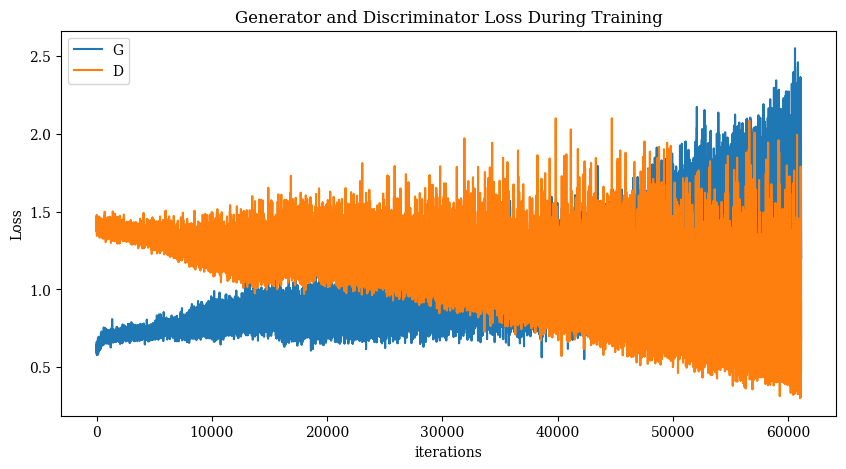

In [307]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

NameError: name 'model' is not defined

In [278]:
from random import randint
def make_binary(x, n, threshold=0.25, min_n=3, apply_filter=True):
    x[x<threshold] = 0.0
    x_ = x
    x_ = x_.argsort(dim=1, descending=True)[:,:n]
    x_ = x_[x.sum(dim=1) >= (n - threshold)]
    
    x_ = th.nn.functional.one_hot(x_, 20).sum(dim=1)
    print(x_.shape)
    x_ = x_[th.logical_and((x_[:,:-1] - x_[:,1:]).abs() == 0,
                            (x_[:,:-1]+x_[:,1:])==2).sum(dim=1) < 1]
    # print(x_)
    
    return x_

In [279]:
[1,2,3][:-1]

[1, 2]

In [313]:
n = 100
_  = netG.eval()
noise = torch.randn(n, nz, device=device)
with torch.no_grad():
    fake = netG(noise)

torch.Size([46, 20])


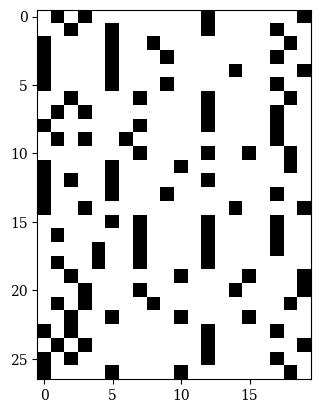

In [315]:
# fake = np.transpose(img_list[-1],(1,2,0))
fake_ = fake
fake_ = make_binary(fake, n=4)
# fake_ = fake_[fake_.sum(dim=1)==4]
plt.imshow(fake_, cmap='binary')

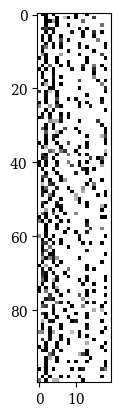

In [300]:
# fake = np.transpose(img_list[-1],(1,2,0))
fake_ = fake
# fake_ = make_binary(fake, n=4)
# fake_ = fake_[fake_.sum(dim=1)==4]
plt.imshow(fake_, cmap='binary')

In [127]:
fake_ = fake[th.logical_and(fake.sum(dim=1)>3.75,fake.sum(dim=1)<=4.00)]

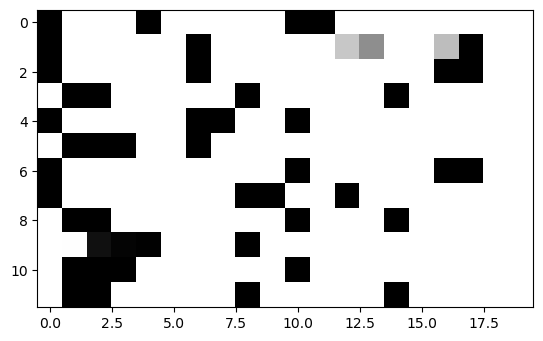

In [128]:
# fake = np.transpose(img_list[-1],(1,2,0))
plt.imshow(fake_, cmap='binary')

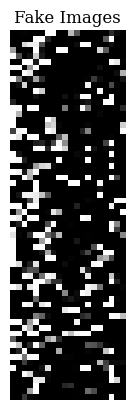

In [46]:
# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()

Truth


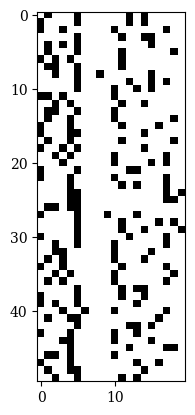

In [142]:
print('Truth')

truth = y
plt.imshow(X[:50,:], cmap='binary')

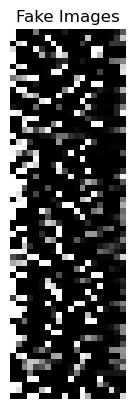

In [110]:
# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()

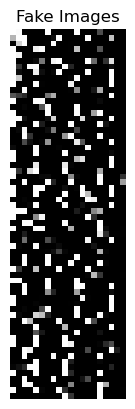

In [51]:
# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()

# save and load model

In [301]:
# save_models([netD, netG], "model_good/")
save_models([netD, netG], "model_new_ok/")

Models saved successfully.


In [108]:
load_models([netD, netG], "model_new_okay/")

Models loaded successfully.


Results
=======

Finally, lets check out how we did. Here, we will look at three
different results. First, we will see how D and G's losses changed
during training. Second, we will visualize G's output on the
fixed\_noise batch for every epoch. And third, we will look at a batch
of real data next to a batch of fake data from G.

**Loss versus training iteration**

Below is a plot of D & G's losses versus training iterations.


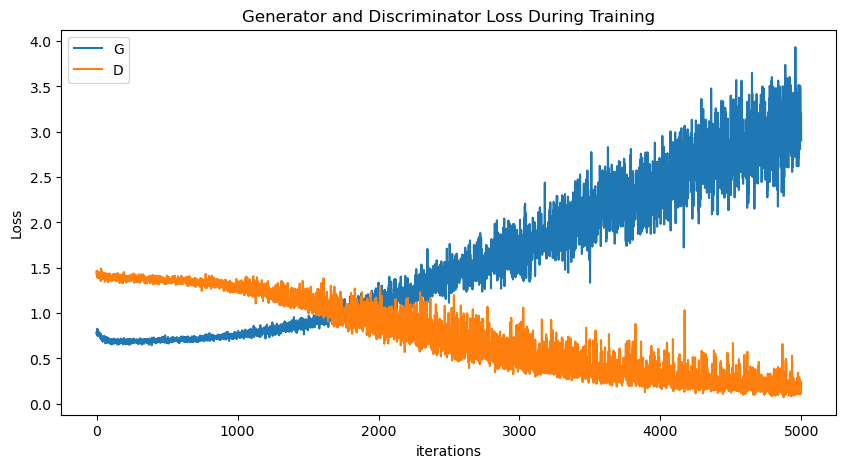

In [94]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

**Visualization of G's progression**

Remember how we saved the generator's output on the fixed\_noise batch
after every epoch of training. Now, we can visualize the training
progression of G with an animation. Press the play button to start the
animation.


In [49]:
len(img_list)

203

Animation size has reached 20980751 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


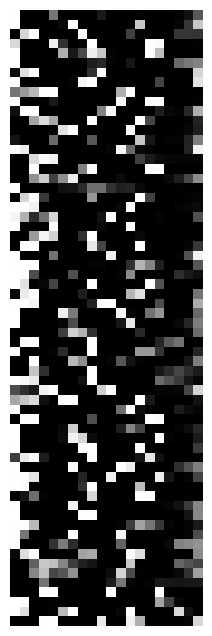

In [105]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

**Real Images vs. Fake Images**

Finally, lets take a look at some real images and fake images side by
side.


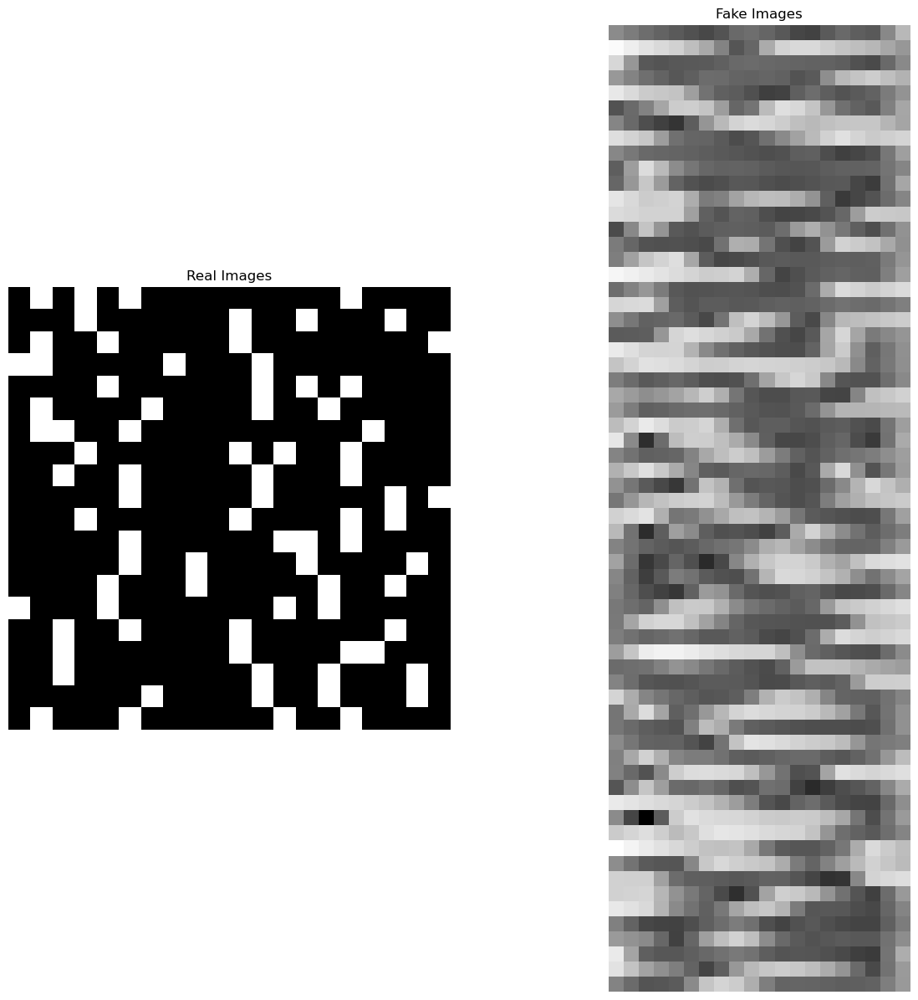

In [96]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()

Where to Go Next
================

We have reached the end of our journey, but there are several places you
could go from here. You could:

-   Train for longer to see how good the results get
-   Modify this model to take a different dataset and possibly change
    the size of the images and the model architecture
-   Check out some other cool GAN projects
    [here](https://github.com/nashory/gans-awesome-applications)
-   Create GANs that generate
    [music](https://www.deepmind.com/blog/wavenet-a-generative-model-for-raw-audio/)
